<a href="https://colab.research.google.com/github/fr3d3rico/mvp_sprint_2_analise_temperatura/blob/main/mvp_sprint_2_analise_temperatura_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MVP de Machine Learning

Sprint 2 - Pós-graduação Ciência de Dados - PUC Rio

Aluno: Frederico Araújo Soares

# 1. Definição do Problema


Será analisado neste MVP os dados de clima disponibilizados pelo Institudo Nacional de Metereologia - INMET.
Serão analisados os dados do clima da cidade de Goiânia para os anos de 2019, 2020, 2021, 2022 e 2023.


O dataset possui uma coluna(feature) chamado **PRECIPITAÇÃO TOTAL, HORÁRIO (mm)**. Esta será nossa feature preditora.
Portanto, teremos um problema de regressão para o valor da precipitação.



## 1.1. Informações Sobre o Dataset

O Instituto Nacional de Metereologia (INMET) está hoje sob a pasta do Ministério da Agricultura e Pecuária.

O Sistema de Coleta e Distribuição de Dados Meteorológicos do Instituto (temperatura, umidade relativa do ar, direção e velocidade do vento, pressão atmosférica, precipitação, entre outras variáveis) é dotado de estações de sondagem de ar superior (radiossonda); estações meteorológicas de superfície, operadas manualmente; e a maior rede de estações automáticas da América do Sul.

A rede de estações meteorológicas automáticas utiliza o que há de mais moderno internacionalmente. Os dados coletados por essa rede são disseminados, de forma democrática e gratuita, em tempo real, na página https://portal.inmet.gov.br, e têm aplicação em todos os setores da economia, de modo especial no agropecuário e em apoio à Defesa Civil.

Os dados estão presentes nos seguintes links:

Dados INMET: https://portal.inmet.gov.br/dadoshistoricos

O link direto para os dados de 2023: https://portal.inmet.gov.br/uploads/dadoshistoricos/2023.zip

O arquivo ZIP possui todos os dados das estações coletadas no Brasil. É necessário verificar nestes dados qual a estação próxima do seu interesse para a análise. Aqui será analisado os dados da estação da cidade de Goiânia.

## 1.2. Bibliotecas Python Utilizadas

In [1]:
# bibliotecas para trabalhar com matrizes, Series e cálculos estatísticos
import pandas as pd
import numpy as np
from scipy import stats

# Visualizações gráficas
import missingno as ms
import seaborn as sns
import matplotlib.pyplot as plt

# Transformações e Holdout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest # para a Seleção Univariada
from sklearn.feature_selection import f_classif # para o teste ANOVA da Seleção Univariada

from sklearn.model_selection import KFold # para preparar os folds da validação cruzada
from sklearn.model_selection import cross_val_score # para executar a validação cruzada
from sklearn.metrics import mean_squared_error # métrica de avaliação MSE
from sklearn.linear_model import LinearRegression # algoritmo Regressão Linear
from sklearn.linear_model import Ridge # algoritmo Regularização Ridge
from sklearn.linear_model import Lasso # algoritmo Regularização Lasso
from sklearn.neighbors import KNeighborsRegressor # algoritmo KNN
from sklearn.tree import DecisionTreeRegressor # algoritmo Árvore de Regressão
from sklearn.svm import SVR # algoritmo SVM
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor # algoritmo da família do RandomForest para Regressão

from sklearn.pipeline import Pipeline

In [2]:
# configuração para não exibir os warnings
import warnings
warnings.filterwarnings("ignore")

# 2. Carga de Dados

O início da análise começa com carregamento em memória dos dados do dataset. A biblieoteca Pandas, aqui sendo utilizada pela variável pd será utilizada para o carregamento.
Um dos parâmetros utilizado é o skiprows. Este parametro recebe a quantidade de linhas que se dejesa ignorar. Em cada dataset presente nos dados do INMET, contêm os dados da região, nome da cidade, latitude e longitude da estão e outros. E todas as 8 primeiras linhas serão ignoradas.

In [3]:
arquivos_csv = ['https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2023_A_30-11-2023.CSV',
                'https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2022_A_31-12-2022.CSV',
                'https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2021_A_31-12-2021.CSV',
                'https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2020_A_31-12-2020.CSV',
                'https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/INMET_CO_GO_A002_GOIANIA_01-01-2019_A_31-12-2019.CSV']

dfs = []

for arquivo in arquivos_csv:
    df = pd.read_csv(arquivo, delimiter=';', encoding='unicode_escape', skiprows=8)
    dfs.append(df)

dataset = []
dataset = pd.concat(dfs, ignore_index=True)

In [4]:
len(dataset), dataset.shape

(43080, (43080, 21))

# 3. Análise de Dados

A análise dos dados envolve a verificação se estão todos formatados e com o dataset carregado em memória para processamento sem erros e alertas.

Uma primeira verificação básica é validar se os dados foram carregados e estão presentes nas features esperadas. Para isso vamos visualizar as primeiras e últimoas instâncias do dataset.

In [5]:
# Validação se os dados foram carregados com sucesso. Visualizando as primeiras linhas do dataset
dataset.head()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),...,TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19,RADIACAO GLOBAL (KJ/m²)
0,2023/01/01,0000 UTC,0,"933,2","933,2","932,5",NaN,"21,1","19,2","21,3",...,"19,6","19,1",90.0,88.0,89.0,115.0,"4,4","1,1",NaN,NaN
1,2023/01/01,0100 UTC,0,933,"933,3",933,NaN,"21,1","19,3","21,2",...,"19,5","19,2",90.0,89.0,90.0,114.0,"2,4",",5",NaN,NaN
2,2023/01/01,0200 UTC,0,933,933,"932,8",NaN,"20,7","19,3","21,1",...,"19,4","19,1",92.0,90.0,92.0,33.0,"1,6",0,NaN,NaN
3,2023/01/01,0300 UTC,0,"932,7","933,2","932,7",NaN,"20,7","19,4","20,8",...,"19,4","19,1",92.0,92.0,92.0,148.0,"2,1",",7",NaN,NaN
4,2023/01/01,0400 UTC,0,"932,2","932,7","932,2",NaN,"20,5","19,1","20,7",...,"19,3","19,1",92.0,92.0,92.0,146.0,"2,2",",8",NaN,NaN


Próximo passo iremos visualizar os últimos dados do dataset.

In [6]:
# Visualizando as últimas linhas do dataset
dataset.tail()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),...,TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19,RADIACAO GLOBAL (KJ/m²)
43075,2019/12/31,1900 UTC,"21,4",928,"929,6","927,5",NaN,20,"18,6","29,7",...,"18,7","16,4",92.0,46.0,92.0,332.0,"18,2","3,3",NaN,"129,2"
43076,2019/12/31,2000 UTC,"11,6","928,5","928,9","927,9",NaN,"21,5","20,1","21,5",...,"20,2","18,5",93.0,92.0,92.0,333.0,8,",9",NaN,"186,4"
43077,2019/12/31,2100 UTC,",2","927,7","928,5","927,6",NaN,"21,6","19,8","22,1",...,"20,4","19,7",92.0,89.0,90.0,303.0,"2,8",",4",NaN,"252,9"
43078,2019/12/31,2200 UTC,0,"927,9",928,"927,7",NaN,"21,3","18,9","21,9",...,20,"18,9",90.0,86.0,86.0,323.0,"4,5",",2",NaN,"34,3"
43079,2019/12/31,2300 UTC,0,"928,7","928,9","927,8",NaN,21,"19,2","21,3",...,"19,2","18,7",89.0,86.0,89.0,236.0,"1,8",",1",NaN,NaN


# coluna radiacao errada

In [7]:
dataset.columns

Index(['Data', 'Hora UTC', 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)',
       'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)',
       'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)',
       'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)',
       'RADIACAO GLOBAL (Kj/m²)',
       'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)',
       'TEMPERATURA DO PONTO DE ORVALHO (°C)',
       'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)',
       'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)',
       'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)',
       'UMIDADE RELATIVA DO AR, HORARIA (%)',
       'VENTO, DIREÇÃO HORARIA (gr) (° (gr))', 'VENTO, RAJADA MAXIMA (m/s)',
       'VENTO, VELOCIDADE HORARIA (m/s)', 'Unnamed: 19',
       'RADIACAO GLOBAL (KJ/m²)'],
      dtype='object')

In [8]:
# Verificando a quantidade de dados faltantes
dataset.isnull().sum()

Data                                                         0
Hora UTC                                                     0
PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                          2052
PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)      174
PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)            189
PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)           189
RADIACAO GLOBAL (Kj/m²)                                  24936
TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)               174
TEMPERATURA DO PONTO DE ORVALHO (°C)                       174
TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)                 189
TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)                 189
TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)           189
TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)           189
UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)                   189
UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)                   189
UMIDADE RELATIVA DO AR, HORARIA (%)                    

<Axes: >

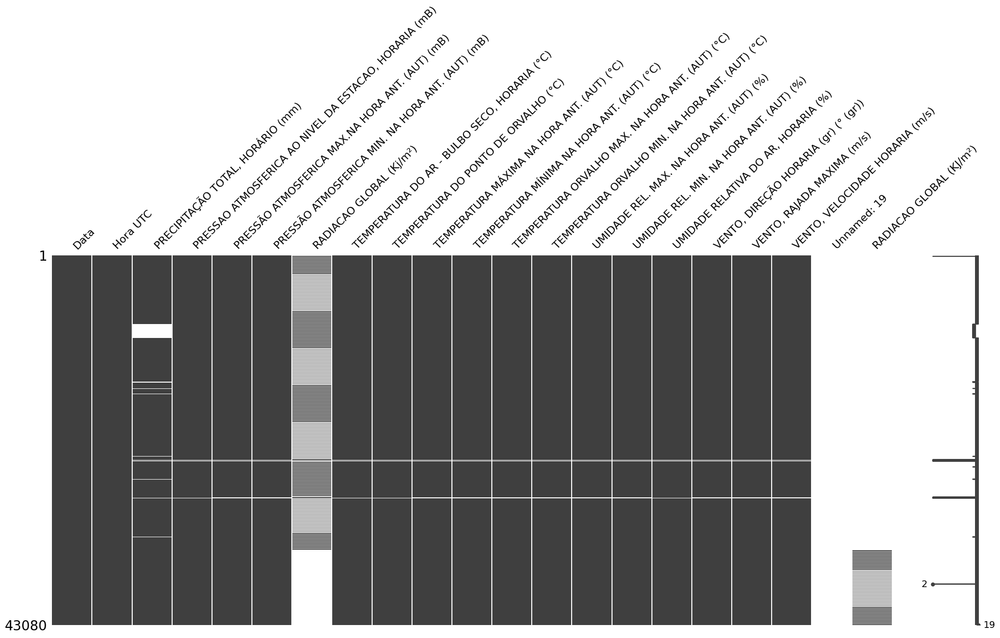

In [9]:
# Visualizando a matriz de valores nulos, é possível ver que as duas colunas tem muitos missings.
# E é possível ver também que os valores se complementam.
ms.matrix(dataset)

In [10]:

# Combinando as colunas das duas colunas que possuem valores

dataset['RADIACAO GLOBAL (Kj/m²)'] = dataset['RADIACAO GLOBAL (Kj/m²)'].combine_first(dataset['RADIACAO GLOBAL (KJ/m²)'])
dataset = dataset.drop(['RADIACAO GLOBAL (KJ/m²)'], axis=1)

In [11]:
# Conferêmcia da coluna. A coluna 'RADIACAO GLOBAL (KJ/m²)' foi removida
dataset.columns

Index(['Data', 'Hora UTC', 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)',
       'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)',
       'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)',
       'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)',
       'RADIACAO GLOBAL (Kj/m²)',
       'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)',
       'TEMPERATURA DO PONTO DE ORVALHO (°C)',
       'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)',
       'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)',
       'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)',
       'UMIDADE RELATIVA DO AR, HORARIA (%)',
       'VENTO, DIREÇÃO HORARIA (gr) (° (gr))', 'VENTO, RAJADA MAXIMA (m/s)',
       'VENTO, VELOCIDADE HORARIA (m/s)', 'Unnamed: 19'],
      dtype='object')

### Abreviando os nomes para facilitar na hora de fazer a impressão dos gráficos

Para facilitar a impressão de gráficos nos passos seguintes, foi necessário abreviar alguns dos nomes das features. A abreviação ainda continuar mantendo o seu significado, mas pode ser consultado aqui nesta seção caso necessário.

In [12]:
# Abreviando os nomes das colunas
dataset = dataset.rename(columns={
'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)': 'PREC.TOTAL,HORA(mm)',
'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)': 'PRES.ATM.NIVEL ESTACAO,HORA(mB)',
'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)': 'PRES.ATM.MAX.HORA ANT.(AUT)(mB)',
'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)': 'PRES.ATM.MIN.HORA ANT.(AUT)(mB)',
'RADIACAO GLOBAL (Kj/m²)': 'RADIACAO GLOBAL(Kj/m²)',
'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)': 'TEMP.AR-BULBO SECO,HORA(°C)',
'TEMPERATURA DO PONTO DE ORVALHO (°C)': 'TEMP.PONTO ORVALHO(°C)',
'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)': 'TEMP.MAX.HORA ANT.(AUT)(°C)',
'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)': 'TEMP.MIN.HORA ANT.(AUT)(°C)',
'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)': 'TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)',
'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)': 'TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)',
'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)': 'UMIDADE REL.MAX.HORA ANT.(AUT)(%)',
'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)': 'UMIDADE REL.MIN.HORA ANT.(AUT)(%)',
'UMIDADE RELATIVA DO AR, HORARIA (%)': 'UMIDADE RELATIVA AR,HORA(%)',
'VENTO, DIREÇÃO HORARIA (gr) (° (gr))': 'VENTO, DIRECAO HORARIA(gr)(°(gr))',
'VENTO, RAJADA MAXIMA (m/s)': 'VENTO, RAJADA MAX.(m/s)',
'VENTO, VELOCIDADE HORARIA (m/s)': 'VENTO, VELOCIDADE HORARIA(m/s)'
}, errors="raise")

## 3.1. Estatísticas Descritivas

## 3.2. Dados Técnicos

Vamos iniciar visualizando o formato ou a dimensão do dataset.

In [13]:
# Visualizando as dimensões do dataset
print(dataset.shape)

(43080, 20)


Vamos verificar os dados técnicos sobre os tipos de variáveis presentes em cada feature que foi identificado no carregamento inicial da biblioteca Pandas.

In [14]:
# Mostra informações técnicas do dataset
print(dataset.dtypes)

Data                                    object
Hora UTC                                object
PREC.TOTAL,HORA(mm)                     object
PRES.ATM.NIVEL ESTACAO,HORA(mB)         object
PRES.ATM.MAX.HORA ANT.(AUT)(mB)         object
PRES.ATM.MIN.HORA ANT.(AUT)(mB)         object
RADIACAO GLOBAL(Kj/m²)                  object
TEMP.AR-BULBO SECO,HORA(°C)             object
TEMP.PONTO ORVALHO(°C)                  object
TEMP.MAX.HORA ANT.(AUT)(°C)             object
TEMP.MIN.HORA ANT.(AUT)(°C)             object
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)     object
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)     object
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      float64
UMIDADE RELATIVA AR,HORA(%)            float64
VENTO, DIRECAO HORARIA(gr)(°(gr))      float64
VENTO, RAJADA MAX.(m/s)                 object
VENTO, VELOCIDADE HORARIA(m/s)          object
Unnamed: 19                            float64
dtype: object


Vamos verificar o tamanho do dataset. Veja que é mostrado as seguintes informações:
- Total de features
- Nomes das features
- Tipo de dados (aqui no caso object e float64 presentes)
- O tipo do dataset (pandas.core.frame.DataFrame)
- O total de linhas (RangeIndex)
- A quantidade de linhas não nulas para cada feature
- Total de memória utilizada (memory usage)

In [15]:
print(dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43080 entries, 0 to 43079
Data columns (total 20 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Data                                 43080 non-null  object 
 1   Hora UTC                             43080 non-null  object 
 2   PREC.TOTAL,HORA(mm)                  41028 non-null  object 
 3   PRES.ATM.NIVEL ESTACAO,HORA(mB)      42906 non-null  object 
 4   PRES.ATM.MAX.HORA ANT.(AUT)(mB)      42891 non-null  object 
 5   PRES.ATM.MIN.HORA ANT.(AUT)(mB)      42891 non-null  object 
 6   RADIACAO GLOBAL(Kj/m²)               22780 non-null  object 
 7   TEMP.AR-BULBO SECO,HORA(°C)          42906 non-null  object 
 8   TEMP.PONTO ORVALHO(°C)               42906 non-null  object 
 9   TEMP.MAX.HORA ANT.(AUT)(°C)          42891 non-null  object 
 10  TEMP.MIN.HORA ANT.(AUT)(°C)          42891 non-null  object 
 11  TEMP.ORVALHO MAX.HORA ANT.(A

Vamos realizar um análise estatística básica sobre o nosso dataset. Este resumo mostra dados de cada feature como:
- Média
- Desvio Padrão
- Valor Mínimo
- Valor Máximo
- Valores do Quartis

Veja que temos um problema. Acima quando analisamos os dados técnicos carregados, foi visualizado que existem 20 colunas (features). Mas aqui na análise estatística foi apresentado somente 5 colunas.

In [16]:
# Análise estatística básica inicial (média, desvio padrão, mínimo, máximo e os quartis)
dataset.describe()

,UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))",Unnamed: 19
count,42891.000000,42891.000000,42891.000000,42894.000000,0.0
mean,65.714579,59.088853,62.401879,173.570103,NaN
std,21.995714,23.191186,22.731016,105.045705,NaN
min,9.000000,8.000000,10.000000,1.000000,NaN
25%,49.000000,40.000000,44.000000,93.000000,NaN
50%,70.000000,61.000000,65.000000,143.000000,NaN
75%,86.000000,80.000000,83.000000,274.000000,NaN
max,94.000000,94.000000,94.000000,360.000000,NaN


## 3.3. Visualizações Unimodais

Na análise anterior vimos que existe algum problema com o dataset. Vamos verificar se ocorre também no momento de visualizar o gráfico de histograma.

array([[<Axes: title={'center': 'UMIDADE REL.MAX.HORA ANT.(AUT)(%)'}>,
        <Axes: title={'center': 'UMIDADE REL.MIN.HORA ANT.(AUT)(%)'}>],
       [<Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%)'}>,
        <Axes: title={'center': 'VENTO, DIRECAO HORARIA(gr)(°(gr))'}>],
       [<Axes: title={'center': 'Unnamed: 19'}>, <Axes: >]], dtype=object)

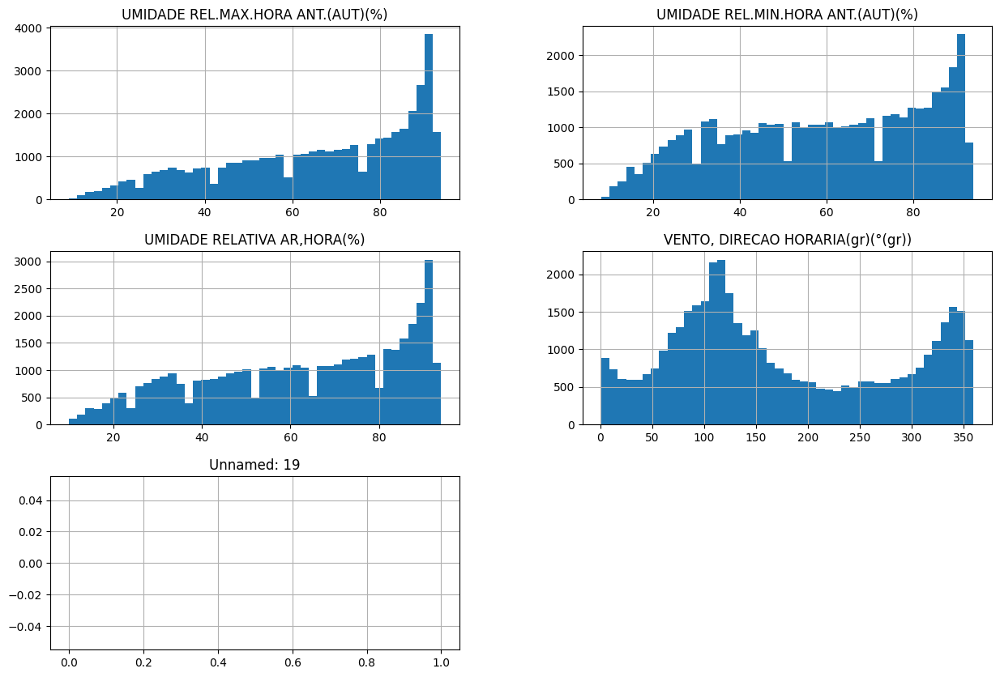

In [17]:
# Histograma
dataset.hist(bins=45, figsize = (15,10))

No início da análise, vimos que o dataset é composto por 20 features, porém aqui vemos somente alguns histogramas. Existe algum problema com os dados que iremos corrigir mais a frente.

## 3.4. Visualizações Multimodais

Vamos verificar se o gráfico de correlações está com problemas também.

In [18]:
# Matriz de Correlação com Matplotlib Seaborn utilizando o método Pearson
try:
  sns.heatmap(dataset.drop(['Data', 'Hora UTC'], axis=1).corr(), annot=True, cmap='RdBu', vmin=-1, vmax=1)
except Exception as error:
  print(f'Não foi possível visualizar a correlação dos dados. Erro = {error}')

Não foi possível visualizar a correlação dos dados. Erro = could not convert string to float: ',2'


Aqui também é possível ver que existe um problema com os dados ao calcular a correlação de Pearson.

## 3.5. Resultado Análise de Dados

Vimos que a análise inicial apresentou alguns problemas. O carregamento do dataset foi realizada com sucesso. Mas existem alguns problemas no dataset.

Ao mostrar novamente abaixo as primeiras linhas com o comando `head()` vemos que algumas features apresentam os seguintes problemas:

- Dados não presentes (NaN)
- Valores informados com vírgula (Python espera que seja ponto)
- Uma coluna com um nome estranho chamada **Unnamed: 19**

In [19]:
dataset.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",Unnamed: 19
0,2023/01/01,0000 UTC,0,"933,2","933,2","932,5",NaN,"21,1","19,2","21,3","21,1","19,6","19,1",90.0,88.0,89.0,115.0,"4,4","1,1",NaN
1,2023/01/01,0100 UTC,0,933,"933,3",933,NaN,"21,1","19,3","21,2","21,1","19,5","19,2",90.0,89.0,90.0,114.0,"2,4",",5",NaN
2,2023/01/01,0200 UTC,0,933,933,"932,8",NaN,"20,7","19,3","21,1","20,7","19,4","19,1",92.0,90.0,92.0,33.0,"1,6",0,NaN
3,2023/01/01,0300 UTC,0,"932,7","933,2","932,7",NaN,"20,7","19,4","20,8","20,5","19,4","19,1",92.0,92.0,92.0,148.0,"2,1",",7",NaN
4,2023/01/01,0400 UTC,0,"932,2","932,7","932,2",NaN,"20,5","19,1","20,7","20,5","19,3","19,1",92.0,92.0,92.0,146.0,"2,2",",8",NaN


# 4. Pré-Processamento de dados

Nesta etapa precisamos corrigir os problemas identificados na análise dos dados na seção anterior e verificar outras questões como:
- Valores faltantes (missings)
- Valores inconsistentes
- Intervalo dos valores
- Unidades de medida

Para isso são utilizadas algumas técnicas. Estas são:
- Limpeza: Que analisa as redundâncias, Outliers e Missings
- Agregação: Que combina dois ou mais dados
- Amostragem com Holdout ou Cross Validation
- Normalização
- Padronização
- Discretização
- One-hot enconding e Dummy enconding
- Feature selection

## 4.1. Tratamento de Missings

Vamos iniciar com o tratamento de missings. Vamos primeiro criar um DataFrame para receber os dados sem os missings.

In [20]:
# Criando o DataFrame que receberá os dados sem os missings
dataset_sem_missings = dataset


# Verificando a quantidade de dados faltantes
dataset_sem_missings.isnull().sum()

Data                                       0
Hora UTC                                   0
PREC.TOTAL,HORA(mm)                     2052
PRES.ATM.NIVEL ESTACAO,HORA(mB)          174
PRES.ATM.MAX.HORA ANT.(AUT)(mB)          189
PRES.ATM.MIN.HORA ANT.(AUT)(mB)          189
RADIACAO GLOBAL(Kj/m²)                 20300
TEMP.AR-BULBO SECO,HORA(°C)              174
TEMP.PONTO ORVALHO(°C)                   174
TEMP.MAX.HORA ANT.(AUT)(°C)              189
TEMP.MIN.HORA ANT.(AUT)(°C)              189
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)      189
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)      189
UMIDADE REL.MAX.HORA ANT.(AUT)(%)        189
UMIDADE REL.MIN.HORA ANT.(AUT)(%)        189
UMIDADE RELATIVA AR,HORA(%)              189
VENTO, DIRECAO HORARIA(gr)(°(gr))        186
VENTO, RAJADA MAX.(m/s)                  192
VENTO, VELOCIDADE HORARIA(m/s)           186
Unnamed: 19                            43080
dtype: int64

<Axes: >

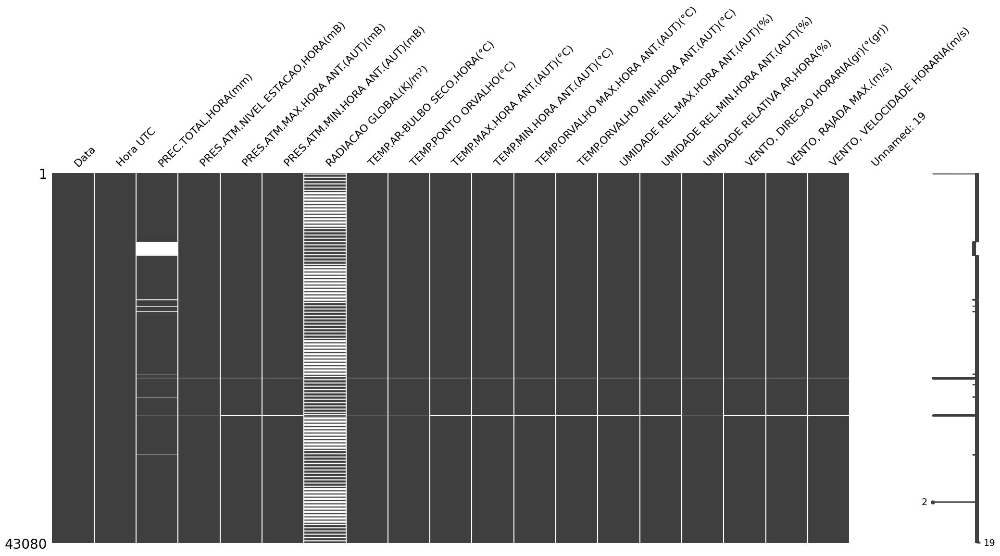

In [21]:
# exibindo visualização matricial da nulidade do dataset
ms.matrix(dataset_sem_missings)

É possível verificar que o gráfico de missings está acusando a feature de Radiação Global com muitos dados faltantes. Neste caso não irei adicionar valores, pois acredito ser algum problema que possa resolvido melhor com o especialista da área.

In [22]:
# Excluindo a feaure sem dados
dataset_sem_missings = dataset_sem_missings.drop(['Unnamed: 19'], axis=1)

In [23]:
# Excluindo as instâncias de dados que possuem ao menos 1 feature faltante
dataset_sem_missings = dataset_sem_missings.dropna()

<Axes: >

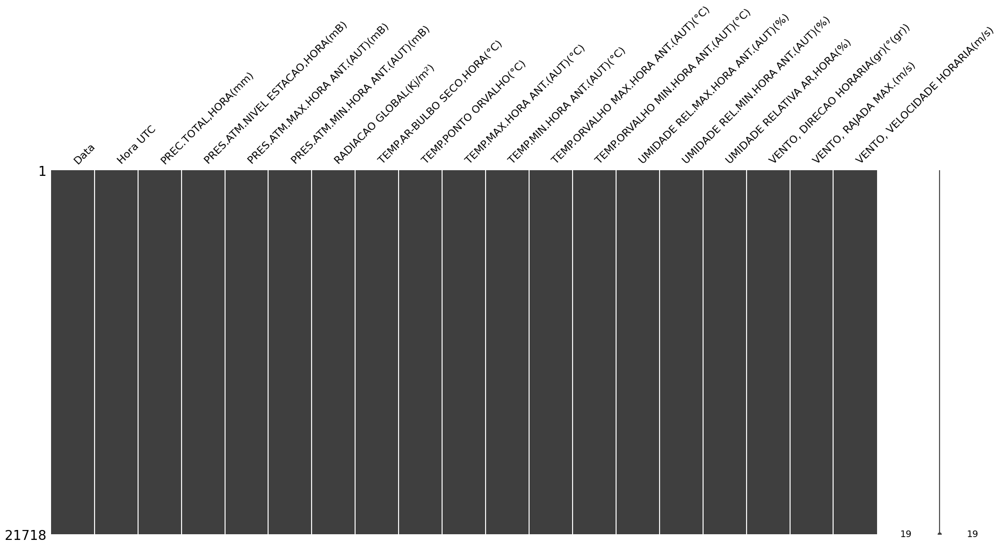

In [24]:
# exibindo visualização matricial da nulidade do dataset
ms.matrix(dataset_sem_missings)

O dataset **datasetSemMissings** está agora sem dados missings. Podemos confirmar a seguir na contagens de features nulas.

In [25]:
# Confirmando que agora não existem mais dados missing
dataset_sem_missings.isnull().sum()

Data                                   0
Hora UTC                               0
PREC.TOTAL,HORA(mm)                    0
PRES.ATM.NIVEL ESTACAO,HORA(mB)        0
PRES.ATM.MAX.HORA ANT.(AUT)(mB)        0
PRES.ATM.MIN.HORA ANT.(AUT)(mB)        0
RADIACAO GLOBAL(Kj/m²)                 0
TEMP.AR-BULBO SECO,HORA(°C)            0
TEMP.PONTO ORVALHO(°C)                 0
TEMP.MAX.HORA ANT.(AUT)(°C)            0
TEMP.MIN.HORA ANT.(AUT)(°C)            0
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)    0
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)    0
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      0
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      0
UMIDADE RELATIVA AR,HORA(%)            0
VENTO, DIRECAO HORARIA(gr)(°(gr))      0
VENTO, RAJADA MAX.(m/s)                0
VENTO, VELOCIDADE HORARIA(m/s)         0
dtype: int64

Veja que agora como foi removido uma feature sem dados, agora a quantidade de colunas passou de 20 para 19.

In [26]:
# Vamos verificar os dados restantes
dataset_sem_missings.shape

(21718, 19)

## 4.2. Transformações Tipos de Dados

Após o tratamento de dados faltantes, vamos verificar as estatísticas básicas.
Veja que ainda continua mostrando somente 5 features do dataset.
O motivo é que os dados estão armazenados no dataset com virgula, porém o Python espera o ponto como formatação de ponto de flutuante.

In [27]:
dataset_sem_missings.describe()

,UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))"
count,21718.000000,21718.000000,21718.000000,21718.000000
mean,57.461000,48.796482,51.930380,178.436781
std,22.795014,22.147584,22.171524,102.279646
min,10.000000,8.000000,10.000000,1.000000
25%,38.000000,30.000000,33.000000,95.000000
50%,58.000000,46.000000,51.000000,156.000000
75%,77.000000,66.000000,70.000000,272.000000
max,94.000000,94.000000,94.000000,360.000000


Vamos realizar a troca do tipo de dados de todas as colunas que não seja a Data e Hora.

In [28]:
# Mudando os tipos de dados para float
for column in dataset_sem_missings.columns:
    if dataset_sem_missings[column].dtype == 'object' and column != 'Data' and column != 'Hora UTC':
        dataset_sem_missings[column] = dataset_sem_missings[column].str.replace(',', '.').astype(float)

dataset_sem_missings.dtypes

Data                                    object
Hora UTC                                object
PREC.TOTAL,HORA(mm)                    float64
PRES.ATM.NIVEL ESTACAO,HORA(mB)        float64
PRES.ATM.MAX.HORA ANT.(AUT)(mB)        float64
PRES.ATM.MIN.HORA ANT.(AUT)(mB)        float64
RADIACAO GLOBAL(Kj/m²)                 float64
TEMP.AR-BULBO SECO,HORA(°C)            float64
TEMP.PONTO ORVALHO(°C)                 float64
TEMP.MAX.HORA ANT.(AUT)(°C)            float64
TEMP.MIN.HORA ANT.(AUT)(°C)            float64
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)    float64
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)    float64
UMIDADE REL.MAX.HORA ANT.(AUT)(%)      float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)      float64
UMIDADE RELATIVA AR,HORA(%)            float64
VENTO, DIRECAO HORARIA(gr)(°(gr))      float64
VENTO, RAJADA MAX.(m/s)                float64
VENTO, VELOCIDADE HORARIA(m/s)         float64
dtype: object

In [29]:
# Agora veja que a estatística básica já está sendo calculada para todas as features
dataset_sem_missings.describe()

,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)"
count,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000,21718.000000
mean,0.179593,932.290100,932.648688,932.049917,1409.475131,26.806396,14.450677,27.622497,25.500751,15.520347,13.579938,57.461000,48.796482,51.930380,178.436781,4.592974,1.372534
std,1.723432,2.924828,2.889565,2.925286,1066.020638,4.675911,5.103802,4.912466,4.907661,4.990695,5.138846,22.795014,22.147584,22.171524,102.279646,2.218388,0.917237
min,0.000000,920.900000,921.000000,920.600000,0.000000,6.000000,-3.900000,6.100000,5.600000,-3.200000,-4.400000,10.000000,8.000000,10.000000,1.000000,0.000000,0.000000
25%,0.000000,930.200000,930.600000,930.000000,348.000000,23.700000,10.700000,24.400000,22.100000,11.900000,9.900000,38.000000,30.000000,33.000000,95.000000,2.900000,0.700000
50%,0.000000,932.300000,932.600000,932.000000,1353.600000,27.300000,15.900000,28.300000,26.100000,17.100000,14.900000,58.000000,46.000000,51.000000,156.000000,4.400000,1.300000
75%,0.000000,934.200000,934.600000,934.000000,2348.300000,30.100000,18.800000,31.000000,28.900000,19.700000,18.000000,77.000000,66.000000,70.000000,272.000000,6.000000,1.900000
max,67.400000,942.200000,942.300000,942.000000,4114.900000,40.000000,23.300000,40.700000,38.300000,24.300000,22.200000,94.000000,94.000000,94.000000,360.000000,23.200000,8.500000


Vamos agora transformar a coluna **Data** do tipo object para datetime. Com essa mudança, poderemos realizar uma visualização gráfica temporal da quantidade de precipitação por mês.

In [30]:
# Transformando a feature Data e Hora em uma somente do tipo datetime para podermos fazer análise temporal
dataset_sem_missings["Hora UTC"] = dataset_sem_missings["Hora UTC"].str.strip(' UTC')
dataset_sem_missings["Data"] =  pd.to_datetime(dataset_sem_missings["Data"] + ' ' + dataset_sem_missings["Hora UTC"], format="%Y/%m/%d %H%M")

In [31]:
# Confirmando a alteração do tipo da Data para dateime
dataset_sem_missings.dtypes

Data                                   datetime64[ns]
Hora UTC                                       object
PREC.TOTAL,HORA(mm)                           float64
PRES.ATM.NIVEL ESTACAO,HORA(mB)               float64
PRES.ATM.MAX.HORA ANT.(AUT)(mB)               float64
PRES.ATM.MIN.HORA ANT.(AUT)(mB)               float64
RADIACAO GLOBAL(Kj/m²)                        float64
TEMP.AR-BULBO SECO,HORA(°C)                   float64
TEMP.PONTO ORVALHO(°C)                        float64
TEMP.MAX.HORA ANT.(AUT)(°C)                   float64
TEMP.MIN.HORA ANT.(AUT)(°C)                   float64
TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)           float64
TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)           float64
UMIDADE REL.MAX.HORA ANT.(AUT)(%)             float64
UMIDADE REL.MIN.HORA ANT.(AUT)(%)             float64
UMIDADE RELATIVA AR,HORA(%)                   float64
VENTO, DIRECAO HORARIA(gr)(°(gr))             float64
VENTO, RAJADA MAX.(m/s)                       float64
VENTO, VELOCIDADE HORARIA(m/

## 4.3. Tratamento de Redundâncias

Outra técnica importante é a validação se existem instâncias duplicadas.

In [32]:
# Mostra a quantidade de instâncias duplicadas
dataset_sem_missings.duplicated().sum()

0

In [33]:
# Mostra a quantidade de instâncias duplicadas levando em consideração somente a combinação de Data e Hora
dataset_sem_missings.duplicated(subset=['Data']).sum()

0

## 4.4. Aplicando Ordenação de Dados Pela Data (datetime)

In [34]:
dataset_sem_missings = dataset_sem_missings.sort_values(by=['Data'])

## 4.5. Tratamento de Outliers

Aqui no gráfico do BoxPlot vemos que existem dados Outliers. Porém ao analisar vemos que ele podem ter entrado como outlier depois que quase metade das instnces foram eliminadas do dataset após o tratamento de missings.

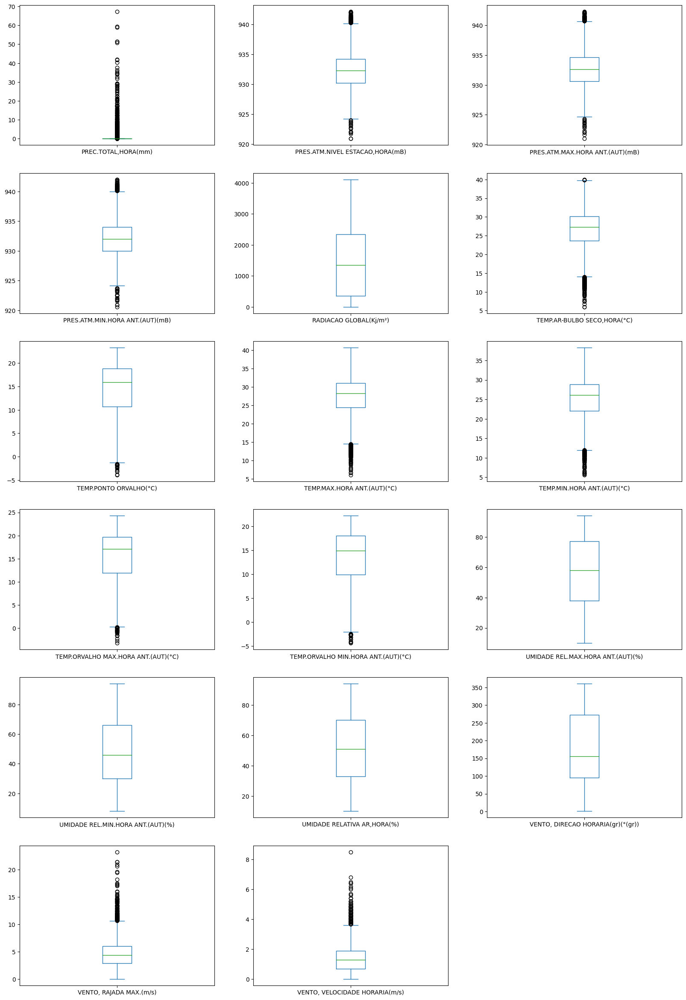

In [35]:
# Boxplot
dataset_sem_missings.plot(kind = 'box', subplots = True, layout = (8,3), sharex = False, sharey = False, figsize = (20,40))
plt.show()

O Boxplot mostra que nossos dados estão com alguns valores sem marcadas como Outliers. No momento não vou retirar estes dados.

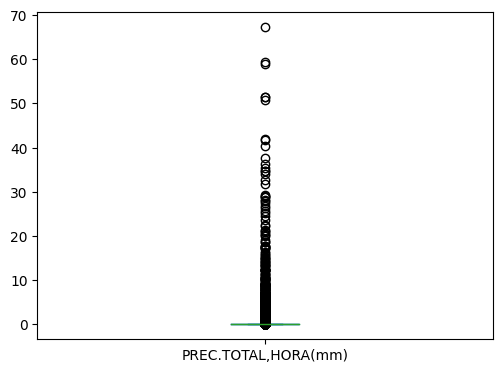

count    21718.000000
mean         0.179593
std          1.723432
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         67.400000
Name: PREC.TOTAL,HORA(mm), dtype: float64


In [36]:
# Boxplot
dataset_sem_missings['PREC.TOTAL,HORA(mm)'].plot(kind = 'box', subplots = True, layout = (8,3), sharex = False, sharey = False, figsize = (20,40))
plt.show()
print(dataset_sem_missings['PREC.TOTAL,HORA(mm)'].describe())

Aqui destaquei as estatísticas descritivas da Precipitação total. Existe uma época do ano em que se chove muito e alguns meses onde não chove. Pode ser este o motivo de ter tanto outliers. No momento não irei retira-lós.

## 4.6. Tratamento One-Hot Encode, Dummy Encode e Criação de Features

Neste dataset não foi necessário utilizar as técnidas de Encode. Porém em alguns datasets existem features categóricas que podem exigir o uso destas técnicas.

Para esta análise decidi adicionar a feature com o número do mês da precipitação analisada.

In [37]:
# criando a coluna do mês
dataset_sem_missings['MES(NUMERO)'] = dataset_sem_missings['Data'].dt.month
dataset_sem_missings.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C),TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C),UMIDADE REL.MAX.HORA ANT.(AUT)(%),UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO)
34329,2019-01-01 09:00:00,0900,0.0,933.4,933.4,932.5,5.8,21.3,19.7,21.4,21.0,19.7,19.2,90.0,88.0,90.0,262.0,0.3,0.0,1
34330,2019-01-01 10:00:00,1000,0.0,934.3,934.3,933.4,195.7,22.3,20.2,22.3,21.3,20.3,19.7,90.0,88.0,88.0,94.0,1.3,0.3,1
34331,2019-01-01 11:00:00,1100,0.0,934.7,934.7,934.2,625.0,23.9,19.8,23.9,22.3,20.4,19.6,88.0,78.0,78.0,311.0,1.8,0.3,1
34332,2019-01-01 12:00:00,1200,0.0,935.2,935.2,934.7,1631.0,25.7,20.1,25.7,23.6,20.2,18.9,78.0,68.0,71.0,358.0,3.0,1.1,1
34333,2019-01-01 13:00:00,1300,0.0,935.1,935.2,935.0,1890.6,26.6,19.3,26.7,24.6,20.4,18.5,74.0,62.0,64.0,16.0,3.6,1.1,1


E em seguida, criei features que médias de dados com relação aos 3 imediatamente anteriores. Acho que é uma feature interessante que possa medir o aumento de um valor com o tempo.

In [38]:
dataset_sem_missings['PREC.TOTAL,HORA(mm) (MEDIA)'] = dataset_sem_missings['PREC.TOTAL,HORA(mm)'].rolling(window=3, min_periods=1).mean()
dataset_sem_missings['UMIDADE RELATIVA AR,HORA(%) (MEDIA)'] = dataset_sem_missings['UMIDADE RELATIVA AR,HORA(%)'].rolling(window=3, min_periods=1).mean()
dataset_sem_missings['TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)'] = dataset_sem_missings['TEMP.AR-BULBO SECO,HORA(°C)'].rolling(window=3, min_periods=1).mean()
dataset_sem_missings['RADIACAO GLOBAL(Kj/m²) (MEDIA)'] = dataset_sem_missings['RADIACAO GLOBAL(Kj/m²)'].rolling(window=3, min_periods=1).mean()

dataset_sem_missings.head()

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",PRES.ATM.MAX.HORA ANT.(AUT)(mB),PRES.ATM.MIN.HORA ANT.(AUT)(mB),RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),...,UMIDADE REL.MIN.HORA ANT.(AUT)(%),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA)
34329,2019-01-01 09:00:00,0900,0.0,933.4,933.4,932.5,5.8,21.3,19.7,21.4,...,88.0,90.0,262.0,0.3,0.0,1,0.0,90.000000,21.300000,5.800000
34330,2019-01-01 10:00:00,1000,0.0,934.3,934.3,933.4,195.7,22.3,20.2,22.3,...,88.0,88.0,94.0,1.3,0.3,1,0.0,89.000000,21.800000,100.750000
34331,2019-01-01 11:00:00,1100,0.0,934.7,934.7,934.2,625.0,23.9,19.8,23.9,...,78.0,78.0,311.0,1.8,0.3,1,0.0,85.333333,22.500000,275.500000
34332,2019-01-01 12:00:00,1200,0.0,935.2,935.2,934.7,1631.0,25.7,20.1,25.7,...,68.0,71.0,358.0,3.0,1.1,1,0.0,79.000000,23.966667,817.233333
34333,2019-01-01 13:00:00,1300,0.0,935.1,935.2,935.0,1890.6,26.6,19.3,26.7,...,62.0,64.0,16.0,3.6,1.1,1,0.0,71.000000,25.400000,1382.200000


Após o tratamento para adicionar novas features com o objetivo de gerar insights, temos as seguintes colunas:

In [39]:
dataset_sem_missings.columns

Index(['Data', 'Hora UTC', 'PREC.TOTAL,HORA(mm)',
       'PRES.ATM.NIVEL ESTACAO,HORA(mB)', 'PRES.ATM.MAX.HORA ANT.(AUT)(mB)',
       'PRES.ATM.MIN.HORA ANT.(AUT)(mB)', 'RADIACAO GLOBAL(Kj/m²)',
       'TEMP.AR-BULBO SECO,HORA(°C)', 'TEMP.PONTO ORVALHO(°C)',
       'TEMP.MAX.HORA ANT.(AUT)(°C)', 'TEMP.MIN.HORA ANT.(AUT)(°C)',
       'TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)',
       'TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)',
       'UMIDADE REL.MAX.HORA ANT.(AUT)(%)',
       'UMIDADE REL.MIN.HORA ANT.(AUT)(%)', 'UMIDADE RELATIVA AR,HORA(%)',
       'VENTO, DIRECAO HORARIA(gr)(°(gr))', 'VENTO, RAJADA MAX.(m/s)',
       'VENTO, VELOCIDADE HORARIA(m/s)', 'MES(NUMERO)',
       'PREC.TOTAL,HORA(mm) (MEDIA)', 'UMIDADE RELATIVA AR,HORA(%) (MEDIA)',
       'TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)',
       'RADIACAO GLOBAL(Kj/m²) (MEDIA)'],
      dtype='object')

## 4.7. Feature Selection

Aqui está sendo realizado uma simulação onde algumas features foram selecionadas para serem removidas. Como verifiquei que existem dados relativos a medição da hora, simulei a retirada da medição máxima e mínima.

In [40]:
dataset_sem_missings = dataset_sem_missings.drop(['PRES.ATM.MAX.HORA ANT.(AUT)(mB)',
                        'PRES.ATM.MIN.HORA ANT.(AUT)(mB)',
                        'UMIDADE REL.MAX.HORA ANT.(AUT)(%)',
                        'UMIDADE REL.MIN.HORA ANT.(AUT)(%)',
                        'TEMP.ORVALHO MAX.HORA ANT.(AUT)(°C)',
                        'TEMP.ORVALHO MIN.HORA ANT.(AUT)(°C)'], axis=1)

## 4.8. Visualizações Após Pré-Processamento

# Visualizações Unimodais

Aqui verificamos a precipitação total mensal. Após o tratamento de missings, o ano de 2022 ficou prejudicado, mas os registros serão treinados.

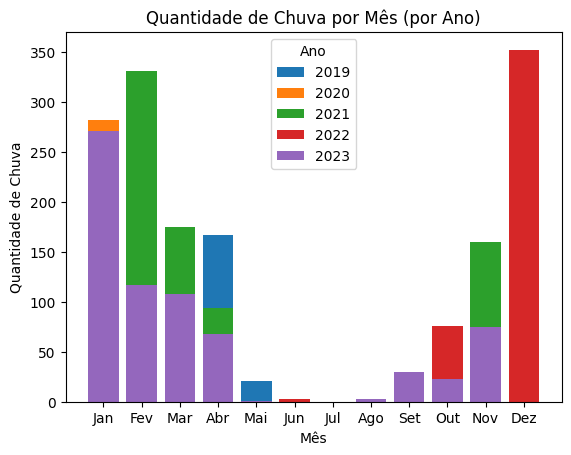

In [41]:
dataset_temp = dataset_sem_missings
dataset_temp['Ano'] = dataset_temp['Data'].dt.year
dataset_temp['Mês'] = dataset_temp['Data'].dt.month

# Agrupando os dados por ano e mês e somando a precipitação de chuva
chuva_por_mes_ano = dataset_temp.groupby(['Ano', 'Mês'])['PREC.TOTAL,HORA(mm)'].sum().reset_index()

# Plotando os dados
for ano in chuva_por_mes_ano['Ano'].unique():
    dados_ano = chuva_por_mes_ano[chuva_por_mes_ano['Ano'] == ano]
    plt.bar(dados_ano['Mês'], dados_ano['PREC.TOTAL,HORA(mm)'], label=str(ano))

plt.xlabel('Mês')
plt.ylabel('Quantidade de Chuva')
plt.title('Quantidade de Chuva por Mês (por Ano)')
plt.legend(title='Ano')
plt.xticks(range(1, 13), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])
plt.show()


Agora um ponto importante. Ao realizar a análise, é importante identificar os dados que possuem uma distribuição normal ou não.
Podemos por exemplo realizar o teste de Shapiro-Wilk(https://en.wikipedia.org/wiki/Shapiro%E2%80%93Wilk_test)

Aqui vamos utilizar a função da biblioteca Scipy (https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.shapiro.html) e vamos imprimir cada valor calculado para cada feature.
Veja a seguir nos gráficos Density Plot e Histrograma que quanto mais próximo de 1 é a distribuição, mais o gráfico se assemelha a um formato de sino como é o caso da feature **PRES.ATM.NIVEL ESTACAO,HORA(mB)**.

E já outras features como **VENTO.DIRECAO HORARIA(gr)(gr)** o valor se afasta de 1 o gráfico é bimodal.


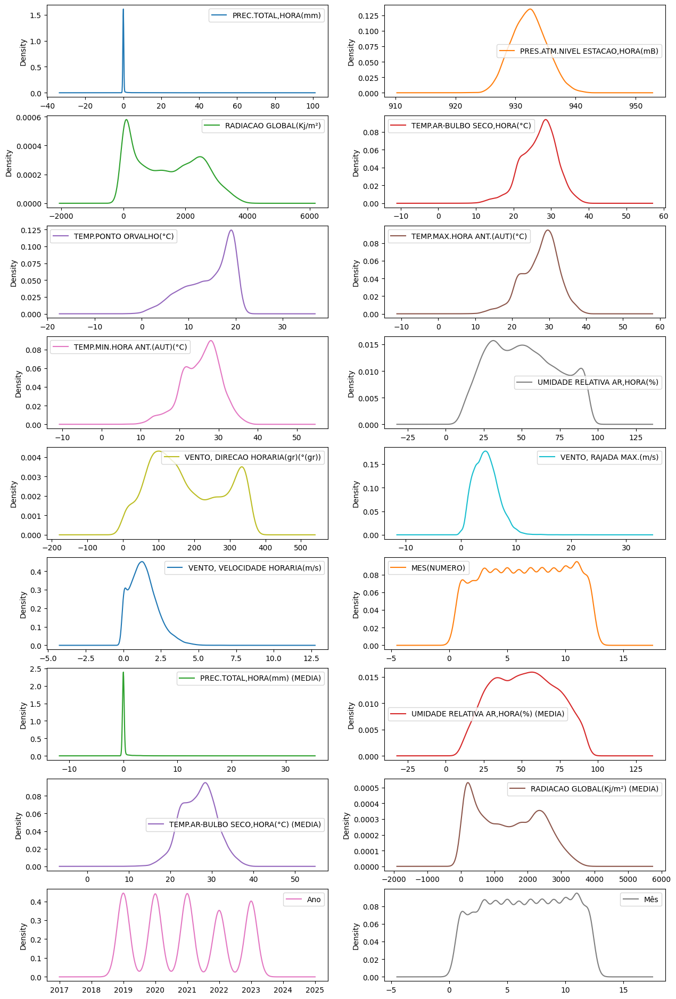

In [42]:
# Aqui apenas crio um dataset temporario sem a feature Data
dataset_density = dataset_sem_missings
dataset_density = dataset_density.drop(['Data'], axis=1)
dataset_density.plot(kind = 'density', subplots = True, layout = (15,2), sharex = False, figsize = (15,40))
plt.show()

O gráfico de densidade mostra as curvas da distribuição dos dados.

Vemos por exemplo que os seguintes gráficos tem um distribuição unimodal:

- TEMP. PONTO ORVALHO(C)

Já o gráfico o seguite gráfico apresenta uma curva multimodal:

- RADIACAO GLOBAL(k/m) (MEDIA)

Algumas das curvas apresentam simetria a esquerda enquanto outras parecem ser normais, como no gráfico da UMIDADE RELATIVA AR,HORA(%) (MEDIA)

array([[<Axes: title={'center': 'Data'}>,
        <Axes: title={'center': 'PREC.TOTAL,HORA(mm)'}>,
        <Axes: title={'center': 'PRES.ATM.NIVEL ESTACAO,HORA(mB)'}>],
       [<Axes: title={'center': 'RADIACAO GLOBAL(Kj/m²)'}>,
        <Axes: title={'center': 'TEMP.AR-BULBO SECO,HORA(°C)'}>,
        <Axes: title={'center': 'TEMP.PONTO ORVALHO(°C)'}>],
       [<Axes: title={'center': 'TEMP.MAX.HORA ANT.(AUT)(°C)'}>,
        <Axes: title={'center': 'TEMP.MIN.HORA ANT.(AUT)(°C)'}>,
        <Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%)'}>],
       [<Axes: title={'center': 'VENTO, DIRECAO HORARIA(gr)(°(gr))'}>,
        <Axes: title={'center': 'VENTO, RAJADA MAX.(m/s)'}>,
        <Axes: title={'center': 'VENTO, VELOCIDADE HORARIA(m/s)'}>],
       [<Axes: title={'center': 'MES(NUMERO)'}>,
        <Axes: title={'center': 'PREC.TOTAL,HORA(mm) (MEDIA)'}>,
        <Axes: title={'center': 'UMIDADE RELATIVA AR,HORA(%) (MEDIA)'}>],
       [<Axes: title={'center': 'TEMP.AR-BULBO SECO,HORA(°C)

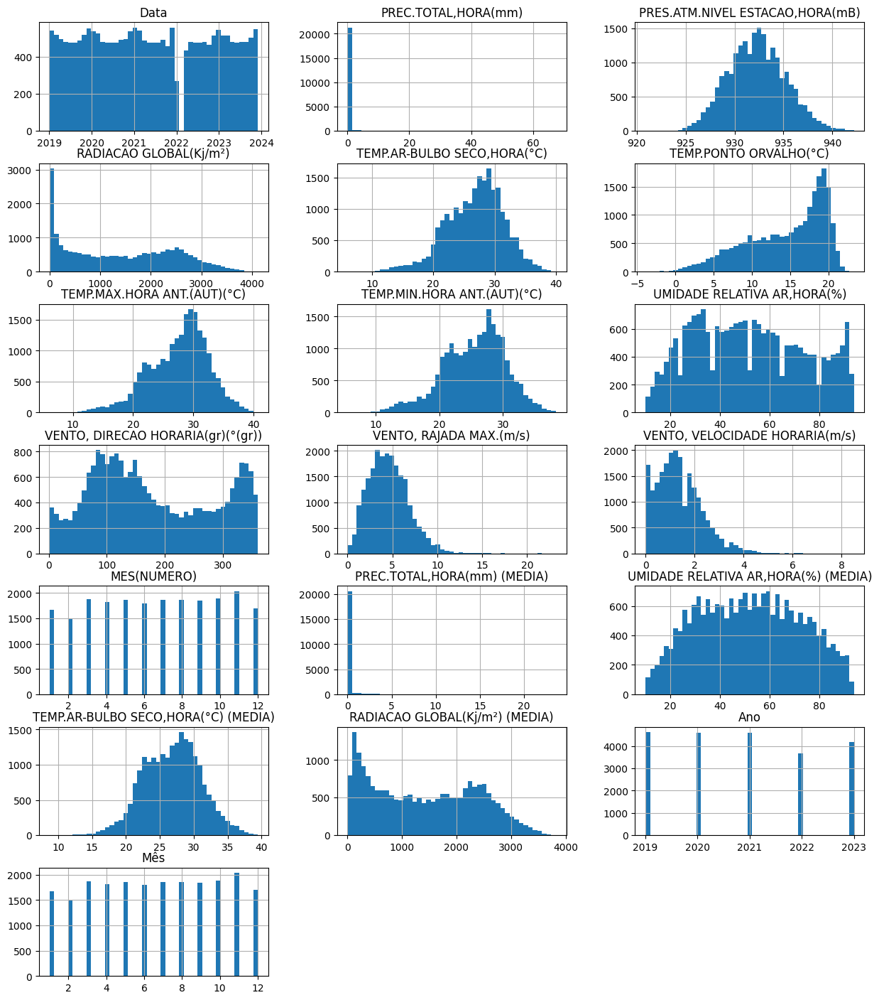

In [43]:
dataset_sem_missings.hist(bins=45, layout=(8,3), figsize = (15,20))

Enquanto o gráfico de densidade mostra as curvas atenuadas pelos valores, já o histograma mostra as frequências relativas em diferentes intervalos.

É uma excelente visualização para ver tendências e padrões.

# Visualizações Multimodais

Aqui faço a impressão da tabela com os valores das correlações calculadas com o método Pearson.

In [44]:
dataset_sem_missings.corr(method = 'pearson')

,Data,Hora UTC,"PREC.TOTAL,HORA(mm)","PRES.ATM.NIVEL ESTACAO,HORA(mB)",RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA),Ano,Mês
Data,1.000000,0.002332,-0.005419,-0.046182,-0.011131,0.012750,-0.067780,0.013919,0.005898,-0.055311,0.019240,-0.051280,-0.079857,0.196615,-0.008251,-0.060182,0.014402,-0.012224,0.980284,0.196615
Hora UTC,0.002332,1.000000,0.038122,-0.438838,-0.045420,0.443235,-0.165014,0.540410,0.554733,-0.396440,0.012315,0.316313,0.114997,-0.040184,0.048876,-0.428129,0.532205,0.299905,0.010151,-0.040184
"PREC.TOTAL,HORA(mm)",-0.005419,0.038122,1.000000,-0.062791,-0.096845,-0.109837,0.099924,-0.053233,-0.092340,0.161525,0.031971,0.160743,0.021125,-0.026802,0.625338,0.106590,-0.049745,-0.048694,-0.000204,-0.026802
"PRES.ATM.NIVEL ESTACAO,HORA(mB)",-0.046182,-0.438838,-0.062791,1.000000,0.063484,-0.341674,-0.330208,-0.392092,-0.425048,-0.047405,-0.305156,-0.039751,0.156502,-0.139447,-0.095120,0.012110,-0.474158,-0.162805,-0.018342,-0.139447
RADIACAO GLOBAL(Kj/m²),-0.011131,-0.045420,-0.096845,0.063484,1.000000,0.642646,-0.168456,0.566109,0.538028,-0.536946,-0.037389,0.402887,0.452338,0.021530,-0.136863,-0.304433,0.376335,0.862418,-0.015792,0.021530
"TEMP.AR-BULBO SECO,HORA(°C)",0.012750,0.443235,-0.109837,-0.341674,0.642646,1.000000,-0.291424,0.974510,0.965247,-0.786321,-0.012470,0.406950,0.335995,0.130536,-0.152460,-0.629520,0.861610,0.773710,-0.013355,0.130536
TEMP.PONTO ORVALHO(°C),-0.067780,-0.165014,0.099924,-0.330208,-0.168456,-0.291424,1.000000,-0.288482,-0.269155,0.774541,0.259260,-0.226886,-0.260343,-0.198223,0.158299,0.811403,-0.313013,-0.261629,-0.029628,-0.198223
TEMP.MAX.HORA ANT.(AUT)(°C),0.013919,0.540410,-0.053233,-0.392092,0.566109,0.974510,-0.288482,1.000000,0.967399,-0.772035,-0.003923,0.452339,0.338697,0.123432,-0.127972,-0.654863,0.891530,0.755289,-0.010738,0.123432
TEMP.MIN.HORA ANT.(AUT)(°C),0.005898,0.554733,-0.092340,-0.425048,0.538028,0.965247,-0.269155,0.967399,1.000000,-0.738880,0.003721,0.424201,0.319199,0.116913,-0.129782,-0.647340,0.917318,0.750140,-0.017678,0.116913
"UMIDADE RELATIVA AR,HORA(%)",-0.055311,-0.396440,0.161525,-0.047405,-0.536946,-0.786321,0.774541,-0.772035,-0.738880,1.000000,0.187231,-0.401167,-0.397221,-0.184120,0.238527,0.899795,-0.687454,-0.662418,-0.019461,-0.184120


Vamos analisar agora o gráfico gerado pela função paiplot. É um ferramenta gráfica muito útil em análise exploratória de dados quando se lida com múltiplas variáveis. Ele cria uma matriz de gráficos de dispersão para visualizar as relações bivariadas entre todas as combinações de variáveis numéricas em um conjunto de dados.

É possível notar as correlações, separação de grupos, tendências lineares e não lineares.

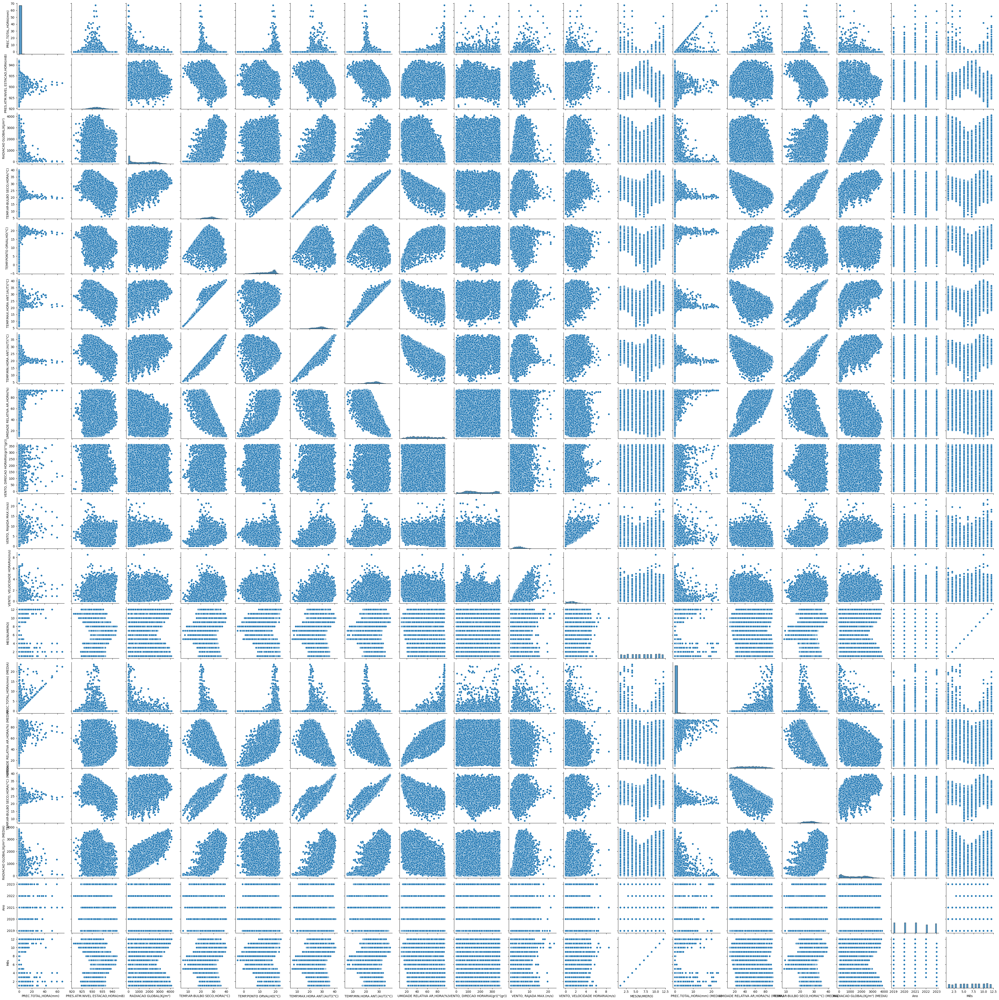

In [45]:
# Scatter Plot com Seaborn - Variação 1

sns.pairplot(dataset_sem_missings)

Vemos que o gráfico pairplot identificou conjuntos de dados em formatos que podem ser úteis nas correlações.

Mas agora vamos verificar como ficaria um gráfico pairplot levando em consideração o hue **Hora UTC**.

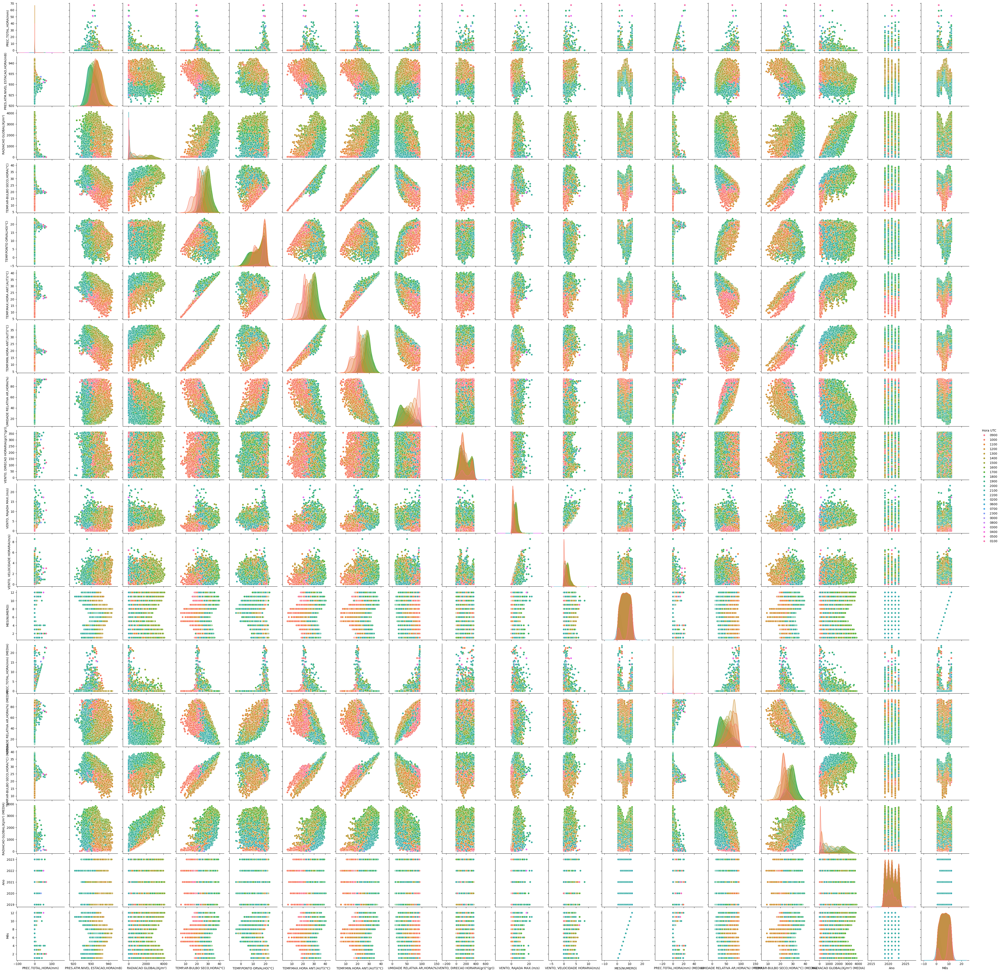

In [46]:
# Scatter Plot com Seaborn - Variação 2

sns.pairplot(dataset_sem_missings, hue = "Hora UTC", height = 2.5);

Veja que é possível verificar um agrupamento das cores que se altera de forma degradê. Isto indica alguns padrões interessantes nos dados que poderão ser explorados.

Vamos analisar as correlações em um mapa de calor. O heatmap mostra que quando há correlção positiva entre os dados e esta correlação é forte, os dados se aproximam do azul (+1.0).

Já quando uma variável aumenta e a outra diminui, vemos que a correlação tem um valor negativo para vermelho. E quanto mais forte se torna esta relação, mais próximo do limite -1.0 se torna.

A matriz mostra que temos algumas features que possuem uma correlação acima de 0.9 e menor que -0.8. É um execelente indicativo de que os tratamento dos dados foram bem aplicados, porém são necessários testes para validar.


<Axes: >

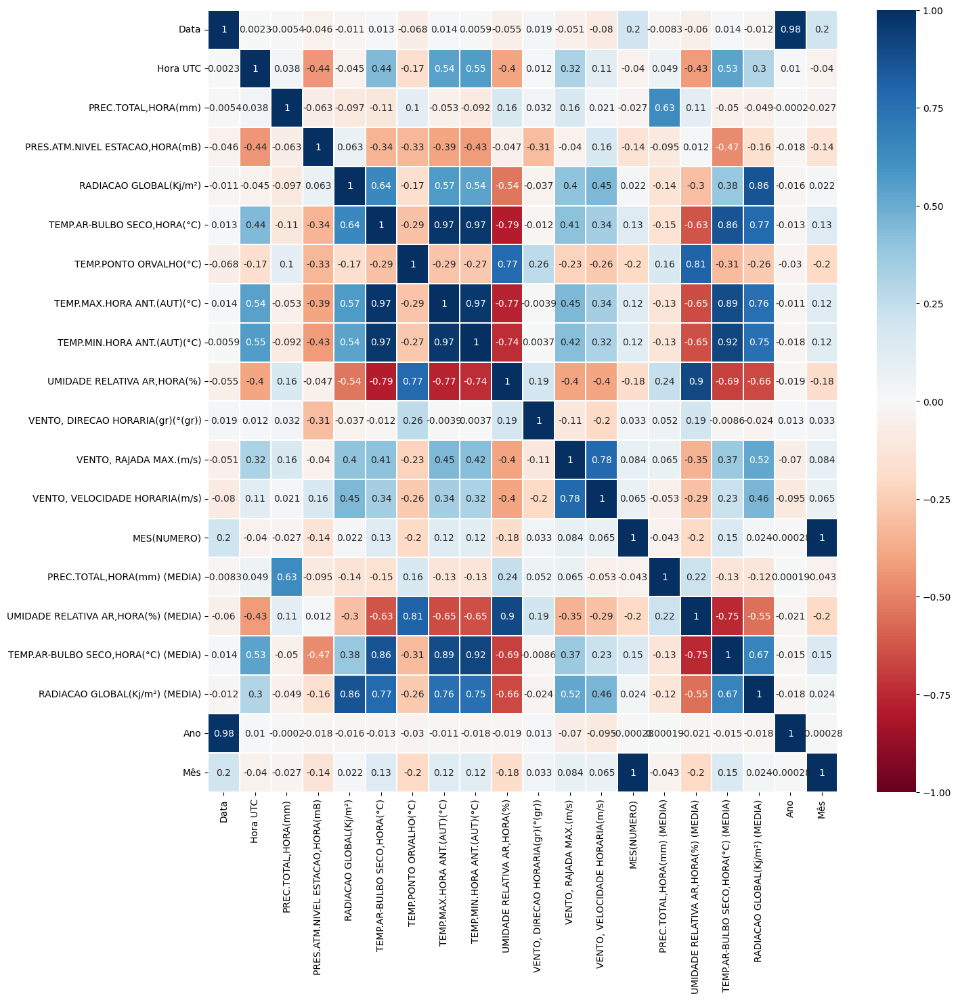

In [47]:
# Visualização do heatmap levando em consideração a correlação de Pearson

fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(dataset_sem_missings.corr(), annot=True, cmap='RdBu', linewidths = .3, vmin=-1, vmax=1, ax=ax)

A seguir, aplicamos a mesma visualização mas utilizando o método de cálculo de Spearman. O método spearman tem sua característica em analisar os dados não lineares. Já o método acima Pearson se beneficia quando os dados tem comportamentos lineares.

<Axes: >

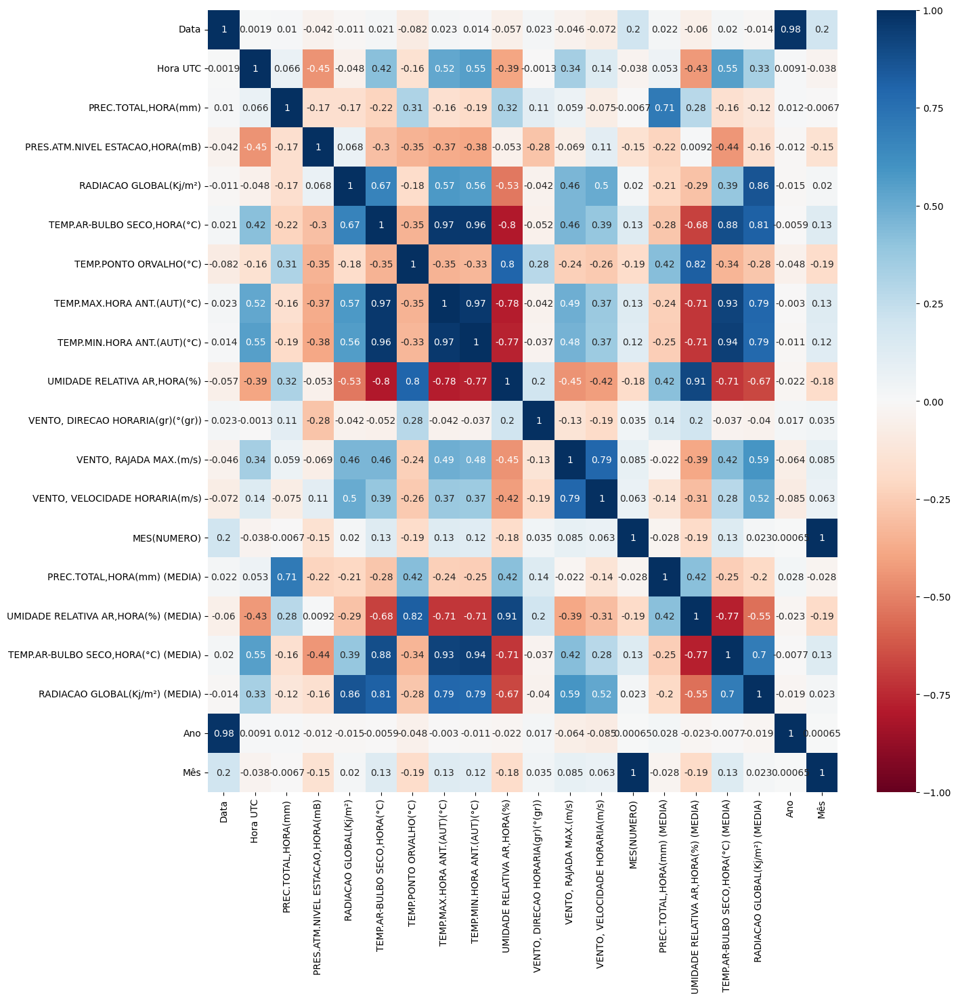

In [48]:
# Visualização do heatmap levando em consideração a correlação de Spearman

fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(dataset_sem_missings.corr(method = 'spearman'), annot=True, cmap='RdBu', vmin=-1, vmax=1, ax = ax)

Algumas correção aqui pelo método Spearman se mostram com valores mais próximos dos limites ideais +1 e -1. Este é o caso entre as seguintes features:

- TEMP.AR-BULBO SECO,HORA(C)
- UMIDADE RELATIVA AR,HORA(%)(MEDIA)

No método Spearman o valor é -0,71. Já no Pearson é -0,66.

## 4.9. Resultado Após Pré-Processamento de dados

O pré-processamento está pronto. Retiramos da análise os dados faltantes e criamos algumas features interessantes para a análise.

Neste pré-processamente não foi realizado a normalização e padronização.

Vimos que as correlações de Pearson e Spearman possuem uma diferença, no caso o Spearman possui um pequena melhora nas correlações.

No passo X foram retiradas todas as instances que tivesse algum dado missing. Esta decisão pode ter retirado dados importantes para a construção do modelo. Mas foi bem executada com o objetivo de apresentar como é realizado a operação de limpeza dos dados.

In [49]:
# Mudando a coluna de precipitação total para a última coluna do dataset
dataset_auxiliar = dataset_sem_missings.pop("PREC.TOTAL,HORA(mm)")
dataset_sem_missings.insert(len(dataset_sem_missings.columns), "PREC.TOTAL,HORA(mm)", dataset_auxiliar)
dataset_sem_missings.shape

(21718, 20)

In [50]:
dataset_sem_missings.head()

,Data,Hora UTC,"PRES.ATM.NIVEL ESTACAO,HORA(mB)",RADIACAO GLOBAL(Kj/m²),"TEMP.AR-BULBO SECO,HORA(°C)",TEMP.PONTO ORVALHO(°C),TEMP.MAX.HORA ANT.(AUT)(°C),TEMP.MIN.HORA ANT.(AUT)(°C),"UMIDADE RELATIVA AR,HORA(%)","VENTO, DIRECAO HORARIA(gr)(°(gr))","VENTO, RAJADA MAX.(m/s)","VENTO, VELOCIDADE HORARIA(m/s)",MES(NUMERO),"PREC.TOTAL,HORA(mm) (MEDIA)","UMIDADE RELATIVA AR,HORA(%) (MEDIA)","TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)",RADIACAO GLOBAL(Kj/m²) (MEDIA),Ano,Mês,"PREC.TOTAL,HORA(mm)"
34329,2019-01-01 09:00:00,0900,933.4,5.8,21.3,19.7,21.4,21.0,90.0,262.0,0.3,0.0,1,0.0,90.000000,21.300000,5.800000,2019,1,0.0
34330,2019-01-01 10:00:00,1000,934.3,195.7,22.3,20.2,22.3,21.3,88.0,94.0,1.3,0.3,1,0.0,89.000000,21.800000,100.750000,2019,1,0.0
34331,2019-01-01 11:00:00,1100,934.7,625.0,23.9,19.8,23.9,22.3,78.0,311.0,1.8,0.3,1,0.0,85.333333,22.500000,275.500000,2019,1,0.0
34332,2019-01-01 12:00:00,1200,935.2,1631.0,25.7,20.1,25.7,23.6,71.0,358.0,3.0,1.1,1,0.0,79.000000,23.966667,817.233333,2019,1,0.0
34333,2019-01-01 13:00:00,1300,935.1,1890.6,26.6,19.3,26.7,24.6,64.0,16.0,3.6,1.1,1,0.0,71.000000,25.400000,1382.200000,2019,1,0.0


# 5. Separação em conjunto de treino e conjunto de teste

Nesta etapa é executado o holdout. Esta operação é executada aqui separando 80% dos dados para treinamento e os 20% finais para validação do modelo.

In [51]:
# Exemplo de separação dos dados de treino e validação
test_size = 0.20
seed = 7

array = dataset_sem_missings.drop(['Data', 'Hora UTC'], axis=1).values
X = array[:,0:15]
y = array[:,15]

X_train, X_test, y_train, y_test = train_test_split(X, y,
    test_size=test_size, shuffle=True, random_state=seed) # sem estratificação

### Foi adicionado esta etapa para salvar o arquivo csv com os dados tratamos.

Este arquivo serve para agilizar o treino, caso algum problema ocorra com os dados tratados.
Pode ser considerado uma boa prática manter os dados tratados separados.

In [52]:
# Salvando o dataset tratado sem missings
dataset_sem_missings.to_csv('mvp-temperature.csv', index=False)

# 6. Criando o Modelo de Machine Learning
Agora que temos todos os dados tratados, podemos treinar vários modelos com o objetivo de verificar qual terá o melhor desempenho para a previsão de precipitação.

In [53]:
dataset_train = pd.read_csv('mvp-temperature.csv')

In [54]:
dataset_train = dataset_train.drop(columns=['Data'], axis=1)
dataset_train = dataset_train.drop(columns=['Hora UTC'], axis=1)
X = dataset_train.drop(['PREC.TOTAL,HORA(mm)'], axis=1)
y = dataset_train['PREC.TOTAL,HORA(mm)']

In [55]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=7) # faz a divisão

num_particoes = 10 # número de folds da validação cruzada
kfold = KFold(n_splits=num_particoes, shuffle=True, random_state=7)

## 6.1 Escolha do modelo

Nesta etapa vamos fazer a escolha do algoritmo para regressão.
Vamos testar os seguinte algoritmos com os valores originais, padronizados e normalizados:
- LinearRegression
- Ridge
- Lasso
- KNeighborsRegressor
- DecisionTreeRegressor (CART)
- SVR (SVM)
- RandomForestRegressor
- GradientBoostingRegressor

No final, será possível visualizar que os melhores modelos foram RandomForestRegressor e GradientBoostingRegressor.

LR-orig: MSE 1.52 (0.81) - RMSE 1.23
Ridge-orig: MSE 1.52 (0.81) - RMSE 1.23
Lasso-orig: MSE 2.41 (1.74) - RMSE 1.55
KNN-orig: MSE 2.60 (1.67) - RMSE 1.61
CART-orig: MSE 1.34 (0.75) - RMSE 1.16
SVM-orig: MSE 2.56 (1.82) - RMSE 1.60
RFR-orig: MSE 0.70 (0.40) - RMSE 0.84
GBR-orig: MSE 0.66 (0.35) - RMSE 0.81
LR-padr: MSE 1.52 (0.81) - RMSE 1.23
Ridge-padr: MSE 1.52 (0.81) - RMSE 1.23
Lasso-padr: MSE 2.55 (1.82) - RMSE 1.60
KNN-padr: MSE 0.98 (0.55) - RMSE 0.99
CART-padr: MSE 1.30 (0.55) - RMSE 1.14
SVM-padr: MSE 1.69 (1.42) - RMSE 1.30
RFR-padr: MSE 0.70 (0.41) - RMSE 0.84
GBR-padr: MSE 0.67 (0.38) - RMSE 0.82
LR-norm: MSE 1.52 (0.81) - RMSE 1.23
Ridge-norm: MSE 1.52 (0.84) - RMSE 1.23
Lasso-norm: MSE 2.56 (1.81) - RMSE 1.60
KNN-norm: MSE 1.45 (1.00) - RMSE 1.20
CART-norm: MSE 1.31 (0.59) - RMSE 1.15
SVM-norm: MSE 1.91 (1.47) - RMSE 1.38
RFR-norm: MSE 0.70 (0.43) - RMSE 0.84
GBR-norm: MSE 0.68 (0.37) - RMSE 0.82


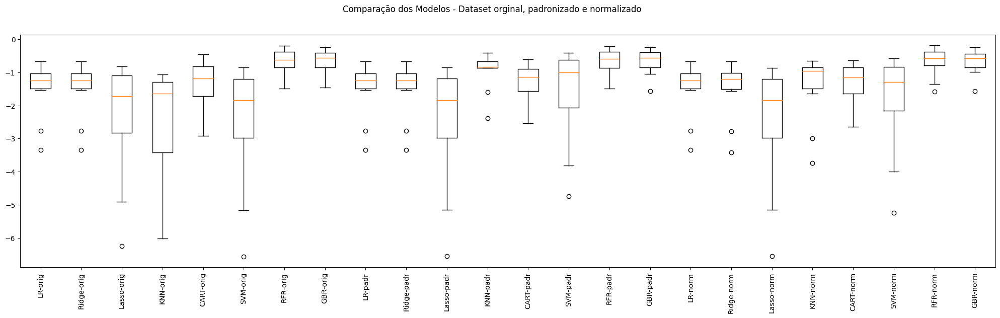

In [56]:
# Modelagem

# Definindo uma seed global para esta célula de código
np.random.seed(7)

# Listas para armazenar os armazenar os pipelines e os resultados para todas as visões do dataset
pipelines = []
results = []
names = []

scoring = 'neg_mean_squared_error'

# Transformações que serão utilizadas
standard_scaler = ('StandardScaler', StandardScaler())
min_max_scaler = ('MinMaxScaler', MinMaxScaler())

# algoritmos
linear_regression = ('LR', LinearRegression())
ridge = ('Ridge', Ridge())
lasso = ('Lasso', Lasso())
knn = ('KNN', KNeighborsRegressor())
cart = ('CART', DecisionTreeRegressor())
svm = ('SVM', SVR())
rfr = ('RFR', RandomForestRegressor(max_depth=10))
gbr = ('GBR', GradientBoostingRegressor())


# Dataset original
pipelines.append(('LR-orig', Pipeline([linear_regression])))
pipelines.append(('Ridge-orig', Pipeline([ridge])))
pipelines.append(('Lasso-orig', Pipeline([lasso])))
pipelines.append(('KNN-orig', Pipeline([knn])))
pipelines.append(('CART-orig', Pipeline([cart])))
pipelines.append(('SVM-orig', Pipeline([svm])))
pipelines.append(('RFR-orig', Pipeline([rfr])))
pipelines.append(('GBR-orig', Pipeline([gbr])))

# Dataset Padronizado
pipelines.append(('LR-padr', Pipeline([standard_scaler, linear_regression])))
pipelines.append(('Ridge-padr', Pipeline([standard_scaler, ridge])))
pipelines.append(('Lasso-padr', Pipeline([standard_scaler, lasso])))
pipelines.append(('KNN-padr', Pipeline([standard_scaler, knn])))
pipelines.append(('CART-padr', Pipeline([standard_scaler, cart])))
pipelines.append(('SVM-padr', Pipeline([standard_scaler, svm])))
pipelines.append(('RFR-padr', Pipeline([standard_scaler, rfr])))
pipelines.append(('GBR-padr', Pipeline([standard_scaler, gbr])))

# Dataset normalizado
pipelines.append(('LR-norm', Pipeline([min_max_scaler, linear_regression])))
pipelines.append(('Ridge-norm', Pipeline([min_max_scaler, ridge])))
pipelines.append(('Lasso-norm', Pipeline([min_max_scaler, lasso])))
pipelines.append(('KNN-norm', Pipeline([min_max_scaler, knn])))
pipelines.append(('CART-norm', Pipeline([min_max_scaler, cart])))
pipelines.append(('SVM-norm', Pipeline([min_max_scaler, svm])))
pipelines.append(('RFR-norm', Pipeline([min_max_scaler, rfr])))
pipelines.append(('GBR-norm', Pipeline([min_max_scaler, gbr])))

def analise_modelos(X_train=X_train, y_train=y_train):
  # Executando os pipelines
  for name, model in pipelines:

      cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='neg_mean_squared_error')
      results.append(cv_results)
      names.append(name)
      msg = "%s: MSE %0.2f (%0.2f) - RMSE %0.2f" % (name, abs(cv_results.mean()), cv_results.std(), np.sqrt(abs(cv_results.mean())))
      print(msg)

  # Boxplot de comparação dos modelos
  fig = plt.figure(figsize=(25,6))
  fig.suptitle('Comparação dos Modelos - Dataset orginal, padronizado e normalizado')
  ax = fig.add_subplot(111)
  plt.boxplot(results)
  ax.set_xticklabels(names, rotation=90)
  plt.show()


# Chamando a função para análise de modelo
analise_modelos()

### Agora vamos analisar com seleção de atributos utilizando o SelectKBest


Número original de atributos: 17
Número reduzido de atributos: 10

Atributos Originais: Index(['PRES.ATM.NIVEL ESTACAO,HORA(mB)', 'RADIACAO GLOBAL(Kj/m²)',
       'TEMP.AR-BULBO SECO,HORA(°C)', 'TEMP.PONTO ORVALHO(°C)',
       'TEMP.MAX.HORA ANT.(AUT)(°C)', 'TEMP.MIN.HORA ANT.(AUT)(°C)',
       'UMIDADE RELATIVA AR,HORA(%)', 'VENTO, DIRECAO HORARIA(gr)(°(gr))',
       'VENTO, RAJADA MAX.(m/s)', 'VENTO, VELOCIDADE HORARIA(m/s)',
       'MES(NUMERO)', 'PREC.TOTAL,HORA(mm) (MEDIA)',
       'UMIDADE RELATIVA AR,HORA(%) (MEDIA)',
       'TEMP.AR-BULBO SECO,HORA(°C) (MEDIA)', 'RADIACAO GLOBAL(Kj/m²) (MEDIA)',
       'Ano', 'Mês'],
      dtype='object')

Atributos Selecionados: ['PRES.ATM.NIVEL ESTACAO,HORA(mB)' 'RADIACAO GLOBAL(Kj/m²)'
 'TEMP.AR-BULBO SECO,HORA(°C)' 'TEMP.PONTO ORVALHO(°C)'
 'TEMP.MAX.HORA ANT.(AUT)(°C)' 'TEMP.MIN.HORA ANT.(AUT)(°C)'
 'UMIDADE RELATIVA AR,HORA(%)' 'VENTO, RAJADA MAX.(m/s)'
 'PREC.TOTAL,HORA(mm) (MEDIA)' 'UMIDADE RELATIVA AR,HORA(%) (MEDIA)']
LR-orig: MSE 2.

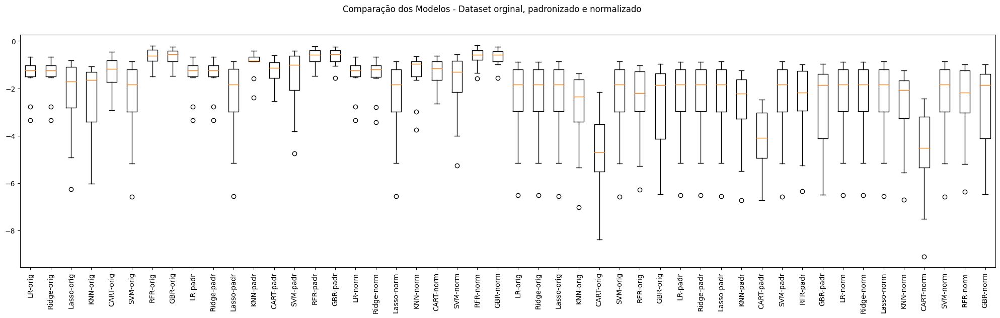

In [57]:
# Analisando com as 10 features selecionadas pela SelectKBest

best_f_classif_var = SelectKBest(score_func=f_classif, k=10)
fit_classif = best_f_classif_var.fit(X, y)
features_classif = fit_classif.transform(X)

# Resultados
print('\nNúmero original de atributos:', X.shape[1])
print('Número reduzido de atributos:', features_classif.shape[1])

# Exibe os atributos orginais
features_selecionadas = best_f_classif_var.get_feature_names_out(input_features=X.columns)
print("\nAtributos Originais:", X.columns)
print("\nAtributos Selecionados:", features_selecionadas)

analise_modelos(X_train=X_train.drop(features_selecionadas, axis=1))


### Agora vamos analisar com seleção de atributos utilizando o PCA.

LR-orig: MSE 2.22 (1.53) - RMSE 1.49
Ridge-orig: MSE 2.22 (1.53) - RMSE 1.49
Lasso-orig: MSE 2.44 (1.73) - RMSE 1.56
KNN-orig: MSE 2.64 (1.73) - RMSE 1.63
CART-orig: MSE 2.17 (0.72) - RMSE 1.47
SVM-orig: MSE 2.55 (1.81) - RMSE 1.60
RFR-orig: MSE 1.43 (0.86) - RMSE 1.20
GBR-orig: MSE 1.61 (0.95) - RMSE 1.27
LR-padr: MSE 2.22 (1.53) - RMSE 1.49
Ridge-padr: MSE 2.22 (1.53) - RMSE 1.49
Lasso-padr: MSE 2.56 (1.81) - RMSE 1.60
KNN-padr: MSE 1.44 (0.95) - RMSE 1.20
CART-padr: MSE 2.42 (0.99) - RMSE 1.56
SVM-padr: MSE 1.90 (1.46) - RMSE 1.38
RFR-padr: MSE 1.42 (0.79) - RMSE 1.19
GBR-padr: MSE 1.60 (0.95) - RMSE 1.26
LR-norm: MSE 2.22 (1.53) - RMSE 1.49
Ridge-norm: MSE 2.22 (1.53) - RMSE 1.49
Lasso-norm: MSE 2.56 (1.81) - RMSE 1.60
KNN-norm: MSE 1.52 (1.03) - RMSE 1.23
CART-norm: MSE 2.29 (1.06) - RMSE 1.51
SVM-norm: MSE 1.96 (1.48) - RMSE 1.40
RFR-norm: MSE 1.42 (0.76) - RMSE 1.19
GBR-norm: MSE 1.59 (0.95) - RMSE 1.26


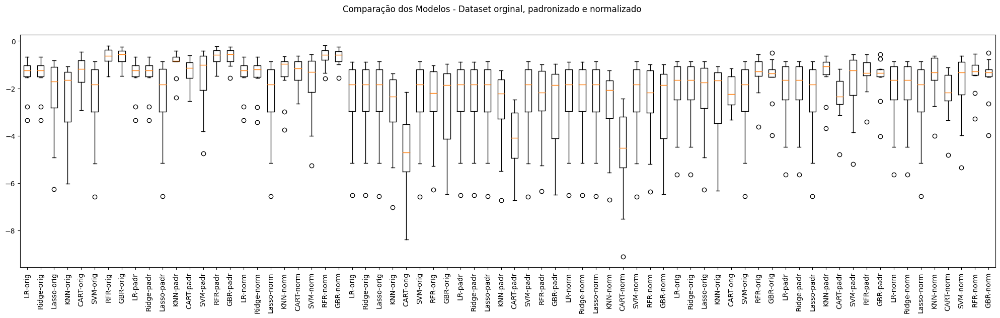

In [58]:
# Analisando com as 10 features selecionadas pelo PCA

pca = PCA(n_components=10)
X_pca = pca.fit_transform(X_train)

#print(X_pca.shape)
#print(y_train.shape)

analise_modelos(X_train=X_pca)


Com a análise dos dados dos modelos sem **feature selection** e **com feature selection**, chegamos na conclusão:
- A análise com **SelectKBest** e **PCA** selecionando 10 features não foram melhores que o conjunto de dados completo.
- A análise com os dados completos os algoritmos **RandomForestRegressor** e **GradientBoostingRegressor** obtiveram uma significativa melhora utilizando padronização(StandardScaler)

**Com isso iremos utilizar aqui o algoritmo GradientBoostingRegressor com StandardScaler.**

## 6.2 Pipeline de treino

Para este modelo foi escolhido o algoritmo GradientBoostingRegressor com padronização.





In [59]:
# Criando o Pipeline
pipe = Pipeline([('scaler', StandardScaler()), ('GBR', GradientBoostingRegressor())])

pipe.fit(X_train, y_train)

predictions = pipe.predict(X_test)

In [60]:
# Estimando o MSE e o RMSE no conjunto de teste
mse = mean_squared_error(y_test, predictions)

print("MSE %0.2f" % mse)
print("RMSE %0.2f" % np.sqrt(abs(mse)))

# Score do modelo
score = pipe.score(X_test, y_test)
print("Score %0.2f" % score)

MSE 1.25
RMSE 1.12
Score 0.73


No gráfico a seguir, visualizamos algumas previsões comparadas com os dados reais. Podemos ver que mesmo que alguns não seja 100% iguais, é possível ver que a intensidade prevista segue a tendência do valor real para alguns casos.

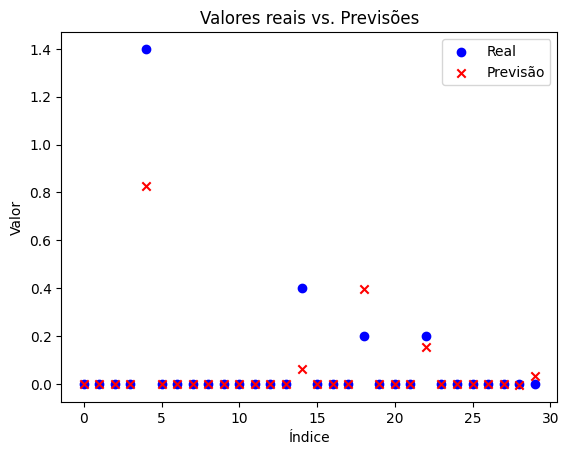

In [61]:
indice_inicial = 310
indice_final = indice_inicial + 30

plt.scatter(range(len(y_test[indice_inicial:indice_final])), y_test[indice_inicial:indice_final], color='blue', label='Real', marker='o')

# Plotar as previsões como uma linha vermelha
plt.scatter(range(len(predictions[indice_inicial:indice_final])), predictions[indice_inicial:indice_final], color='red', label='Previsão', marker='x')

# Adicionar rótulos e legendas
plt.xlabel('Índice')
plt.ylabel('Valor')
plt.title('Valores reais vs. Previsões')
plt.legend()

# Mostrar o gráfico
plt.show()

# 7. Conclusão

O objetivo do projeto foi executado mostrando todas as partes que um projeto de ciência de dados exige. Desde a coleta, tratamento, análise, pré-processamento dos dados e treinamento do modelo. Claro que para finalizar até o deploy da solução ainda existem algumas etapas, mas que serão exploradas na próxima Sprint do curso.

O projeto inicialmente foi pensado para ser implementado utilizando uma rede neural profunda, Deep neural networks (DNN). Várias arquiteturas DNN foram testadas, porém, para o problema específico os erros foram um pouco maiores do que o esperado como mostra a imagem a seguir.

![](https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/loss-dnn-train.png)

A cidade de Goiânia, Brasília e toda região possui um clima seco e sem chuvas entre junho e setembro. Nesse período os dados de precipitações são 0(zero). Com o teste com a arquitetura DNN, os valores previstos ficavam entre 0 e 1, e em uma porcentagem pequena com valores zerados. Como na imagem a acima, vimos que o loss ficou grande acima de 3 seja no início ou final do treino. E mesmo que se usasse uma callback para salvar o melhor modelo com o checkpoint, não consegui alcançar um modelo satisfatório.

A seguir somente dois exemplos das várias variações de DNN que foram testados para este problema:

![](https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/dnn-test.png)

![](https://raw.githubusercontent.com/fr3d3rico/mvp_sprint_2_analise_temperatura/main/dnn-test-2.png)

Gostaria de deixar alguns pontos de atenção que pode ajudar em projetos futuros. Ao executar um projeto de ciência de dados, são necessários alguns processamentos de dados para prepará-los durante a construção de um modelo.
Dois tipos de processamentos são referentes a transformações numéricas, como a normalização e a padronização.

Ao executar este projeto, foi julgado que não seria necessário estas duas transformações no tratamento mas somente a padronização no treino do modelo.
Algumas das features estavam, visualmente, com formatos de distribuições normais. O que neste caso poderia ser aplicado a padronização. Porém, como os dados estavam aparentemente em uma escala bem conhecida e com dados outliers sendo indicados, porém dentro de intervalos reais, preferi não aplicar esta transformação no tratamento.

Com relação as outras features que apresentavam comportamentos visuais exponenciais, poderia ser aplicado a normalização. Porém, também pelo mesmo motivo da padronização, julguei que os dados estavam em uma escala digamos "comportadas" para que não fosse necessário transformar.

Porém, como citado no livro **Engenharia de Software para Ciência de Dados(capítulo 9, página 262)** é importante entender os momentos certos para aplicar estas duas transformações para evitar o *Data Leakage* durante o treinamento do modelo.

# Anexos

### Anexo A - Boas Práticas de Software

1. Na seção 4.1 foi apresentado a funcionalidade que apresenta o gráfico com os dados missings. Foi possível verificar que este trecho de código foi utilizado repetidamente 3 vezes na mesma sessão.

Um boa prática, é criar uma função e reutilizar o código da chamada para realizar a construção do gráfico para anáise.
Veja um exemplo a seguir:

In [62]:
def visualizar_grafico_missings(data_frame):
    col = list(data_frame.columns)
    atributos = data_frame

    # exibindo visualização matricial da nulidade do dataset
    ms.matrix(atributos)


# Exemplo de como utilizar
# visualizar_grafico_missings(dataset)

### Anexo B - Testes com PyTest

Uma boa prática na automatização na construção de modelos de machine learning é a realização de testes durante o pipeline.
Para que os sistemas inteligentes estejam sempre atualizados, além de aplicar boas práticas de códigos, devemos realizar algumas verificações nos dados e nos resultados dos processamentos para garantir que a esteira de implantação fique online a maior parte do tempo.

Realizar testes nos componentes do pipeline garante agilidade, custo menores na operação ao evitar processos errados e qualidade na acurácia do produto entregue.

Durante o pipeline realizamos o carregamento do datasource, processamos, limpamos os dados e treinamos os modelos. Então podemos ver que são bem claras as etapas dos testes.

Como utilizamos a tecnologia Python, é comum utilizar a biblioteca PyTest (https://docs.pytest.org/en/7.4.x/) para realizar os testes.

Por exemplo, segue alguns exemplos de testes para realizar no pipeline.

In [63]:
# Função para teste dos dados carregados
def testa_url_dataset(url):
    # A url informada do dataset não pode estar em branco
    assert len(url) != 0


# Função para testar se o dataset está ok
def testa_dataset_carregado(dt):
    assert dt.notnull
    assert len(dt.columns) == 20 # Dataset inicial esperado para este modelo tem que ter 20 colunas